In [ ]:
USE_COLAB = True

### Load the dataset.

In [ ]:
if USE_COLAB:
    import os
    from google.colab import drive
    drive.mount('drive', force_remount=True)

Mounted at drive


In [ ]:
import os

DIRECTORY_KEY = 'EMOd.key'
NOTEBOOK_NAME = 'humanAttention.ipynb'
DATASET_DIR = None
NOTEBOOK_DIR = None

for (dirpath,dirnames,filenames) in os.walk('drive'):
    if DATASET_DIR is None and DIRECTORY_KEY in filenames:
        DATASET_DIR = dirpath
    if NOTEBOOK_DIR is None and NOTEBOOK_NAME in filenames:
        NOTEBOOK_DIR = dirpath
    if DATASET_DIR is not None and NOTEBOOK_DIR is not None:
        break
if DATASET_DIR is None:
    print('Could not find dataset directory.')
    print(f'Please add an empty file by the name of {DIRECTORY_KEY} to the dataset directory.')
else:
    print(f'Found dataset directory at: {DATASET_DIR}')
if NOTEBOOK_DIR is None:
    print('Could not find notebook directory.')
    print(f'Please make sure that the notebook is named {NOTEBOOK_NAME}.')
else:
    print(f'Found notebook directory at: {NOTEBOOK_DIR}')

Found dataset directory at: drive/MyDrive/MIMe/attention/datasets/EMOd
Found notebook directory at: drive/MyDrive/MIMe/attention


In [ ]:
import os
import numpy
from scipy.io import loadmat

files = os.listdir(DATASET_DIR)
datasets = {}
for fname in files:
    if fname.lower()[-4:] != '.mat':
        continue

    ds = loadmat(DATASET_DIR+os.path.sep+fname)
    print(fname+': '+str(ds.keys()))
    datasets[fname[:-4]] = ds
    

annotation.mat: dict_keys(['__header__', '__version__', '__globals__', 'allfindata1019', 'annotation_list'])
tracking.mat: dict_keys(['__header__', '__version__', '__globals__', 'fixations1019'])


In [ ]:
annotationSet = []
for annotation in datasets['annotation']['annotation_list'][0]:
    annotationSet.append(annotation[0])
print(annotationSet)
print('len: '+str(len(annotationSet)))
print(datasets['annotation']['allfindata1019'].shape)

['image name', 'emo cause', 'tmp emo', 'valence', 'arousal', 'dominance', 'happy', 'surprise', 'awe', 'excitment', 'amusement', 'contentment', 'sad', 'anger', 'fear', 'disgust', 'familiar', 'aesthetic', 'unusual', 'dynamic', 'informative', 'natural objects', 'colorful', 'color combo natural', 'sharp', 'high quality', 'having focused object', 'single focused', 'centered', 'symmetrical', 'close-up shot', 'photorealistic', 'attractive person', 'posing', 'eye contact', 'positive expression']
len: 36
(1019, 36)


In [ ]:
# Indexes -> image, 0, 0, 0 -> (image_name, (fixation, 0, 0, 0, (X, Y, Duration)) -> where x y and duration are (1, sampleCount) shaped
for i in range(1019):
    fixations = datasets['tracking']['fixations1019'][i][0][0][0][1]
    for j in range(fixations.shape[0]):
        fixtype = fixations[j][0].dtype
        print(fixtype)
        fixset = fixations[j][0][0][0]
        xset = fixset[0][0]
        yset = fixset[1][0]
        durset = fixset[2][0]
        for k in range(durset.shape[0]):
            print(durset[k])
        break
    break

[('fix_x', 'O'), ('fix_y', 'O'), ('fix_duration', 'O')]
152
553
216
467
238
156
302
116


## Formatting the Data
To get the data properly in and out of the network, the data must be formatted in such a way that it is readable by the model fitting function. To do this, a data loader will be used

In [ ]:
import os
from PIL import Image
import numpy as np
from scipy import stats

# Load images
# Note: Only 698 images loaded due to apparent IAP dependency
imagePath = DATASET_DIR+os.path.sep+'images'
imageNames = [name for name in os.listdir(imagePath) if name[-4:] == '.jpg']
imageNames.sort()
imageDS = np.asarray([np.asarray(Image.open(imagePath+os.path.sep+name).resize((256,256)), dtype=np.float16) for name in imageNames])
print(f'Image dataset shape: {imageDS.shape}')

# Load continuous fixation maps
attnPath = DATASET_DIR+os.path.sep+'fixations'+os.path.sep+'Continuous_map'
attnNames = [name for name in os.listdir(attnPath) if name[-4:] == '.jpg']
attnNames.sort()
attentionDS = np.asarray([np.asarray(Image.open(attnPath+os.path.sep+name).resize((256,256)), dtype=np.float16) for name in attnNames])/255.
print(f'Attention shape pre trim: {attentionDS.shape}')
attentionDS = attentionDS[:imageDS.shape[0]]
print(f'Attention shape post trim: {attentionDS.shape}')

# Load emotional states
emotionDS = datasets['annotation']['allfindata1019'][:,-32:]
emotionDS[np.isnan(emotionDS)] = 0.
print(f'Emotion shape pre trim: {emotionDS.shape}')
emotionDS = emotionDS[:imageDS.shape[0]]
print(f'Emotion shape post trim: {emotionDS.shape}')

Image dataset shape: (698, 256, 256, 3)
Attention shape pre trim: (1019, 256, 256)
Attention shape post trim: (698, 256, 256)
Emotion shape pre trim: (1019, 32)
Emotion shape post trim: (698, 32)


## Building the Network
The network will be built off of the U-net idea with two output sets coming from the network. The first output set will be from the end of the U-net, at which the attention for the scene will be displayed. The next output set will be from the bottom of the U-net, at which a seperate flow will fork off and encode emtional states using residual data.

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers
from tensorflow.keras.optimizers import *

def buildModel(inputShape=(256, 256, 3), emotionsRepresented=32, uDepth=4, dropout=0.1, ffDim=128, ffDepth=3, weights=None):
    inputs = layers.Input(shape=inputShape)
    x = inputs

    # Build convolutional side of the U-net
    convs = []
    for i in range(uDepth):
        # Only pool if going down
        if i != 0: x = layers.MaxPooling2D(pool_size=(2, 2))(x)

        # Build conv block
        filters = int(64 * (i + 1))
        x = layers.Conv2D(filters, 3, activation='relu', padding='same', kernel_initializer='he_normal')(x)
        x = layers.Conv2D(filters, 3, activation='relu', padding='same', kernel_initializer='he_normal')(x)
        x = layers.LayerNormalization(epsilon=1e-6)(x)
        x = layers.Dropout(dropout)(x)
        convs.append(x)
        
    # Split the U-net and create emotional network
    emo = None
    for conv in convs[::-1][:3]:
      flatConv = layers.MaxPool2D(pool_size=(4, 4))(conv)
      flatConv = layers.Flatten()(flatConv)
      if emo is None:
        emo = flatConv
      else:
        emo = layers.Concatenate()([emo, flatConv])
    # Seperate the emotion network's gradient from the attention network gradient
    #emo = layers.Lambda(lambda x: tf.stop_gradient(x))(emo)
    for i in range(ffDepth):
        emo = layers.LayerNormalization(epsilon=1e-6)(emo)
        emo = layers.Dense(ffDim, activation='relu', kernel_initializer='he_normal')(emo)
    emo = layers.Dense(emotionsRepresented, activation='sigmoid', kernel_initializer='zero', name='emotionalOutput')(emo)

    # Deconvolve the U-net
    for i in range(uDepth-1)[::-1]:
        filters = int(64 * (i + 1))

        # Upsample
        x = layers.Conv2D(filters, 2, activation='relu', padding='same', kernel_initializer='he_normal')(
            layers.UpSampling2D(size=(2, 2))(x)
        )

        # Concatenate and convolve
        x = layers.Concatenate()([x, convs[i]])
        x = layers.Conv2D(filters, 3, activation='relu', padding='same', kernel_initializer='he_normal')(x)
        x = layers.Conv2D(filters, 3, activation='relu', padding='same', kernel_initializer='he_normal')(x)
        x = layers.Dropout(dropout)(x)

    # Create the final image
    attention = layers.Conv2D(1, 1, activation='sigmoid', padding='same', kernel_initializer='zero', name='attentionOutput')(x)
    
    # Finish building the model
    model = tf.keras.Model(inputs=inputs, outputs=[attention, emo], name='lizardEMO')
    model.compile(optimizer=Adam(lr=1e-6), loss=['mae', 'mae'])

    if weights is not None:
        model.load_weights(weights)
    
    return model

In [ ]:
import os
import tensorflow.keras.utils as kutils

PREVIOUS_WEIGHTS = NOTEBOOK_DIR+os.path.sep+'model'+os.path.sep+'mimeAttnCOS.ckpt'+os.path.sep+'variables'+os.path.sep+'variables'

model = buildModel(weights=PREVIOUS_WEIGHTS)
model.summary()

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/optimizer_v2/optimizer_v2.py:375: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  "The `lr` argument is deprecated, use `learning_rate` instead.")


Model: "lizardEMO"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 256, 256, 64) 1792        input_1[0][0]                    
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 256, 256, 64) 36928       conv2d[0][0]                     
__________________________________________________________________________________________________
layer_normalization (LayerNorma (None, 256, 256, 64) 128         conv2d_1[0][0]                   
__________________________________________________________________________________________

## Train the Model

In [ ]:
EPOCHS = 1000
MODEL_SAVE_DIR = NOTEBOOK_DIR+os.path.sep+'model'+os.path.sep+'mimeAttn.ckpt'

cpCallback = tf.keras.callbacks.ModelCheckpoint(filepath=MODEL_SAVE_DIR,
                                                 save_weights_only=False,
                                                 verbose=0)
earlyStop = tf.keras.callbacks.EarlyStopping(patience=5, monitor='loss')
history = model.fit(imageDS, (attentionDS, emotionDS), batch_size=2, epochs=EPOCHS, callbacks=[cpCallback, earlyStop], shuffle=True)

Epoch 1/1000
349/349 [==============================] - 33s 39ms/step - loss: 0.0446 - attentionOutput_loss: 0.0269 - emotionalOutput_loss: 0.0177
INFO:tensorflow:Assets written to: drive/MyDrive/MIMe/attention/model/mimeAttn.ckpt/assets
Epoch 2/1000
349/349 [==============================] - 14s 39ms/step - loss: 0.0412 - attentionOutput_loss: 0.0237 - emotionalOutput_loss: 0.0175
INFO:tensorflow:Assets written to: drive/MyDrive/MIMe/attention/model/mimeAttn.ckpt/assets
Epoch 3/1000
349/349 [==============================] - 14s 39ms/step - loss: 0.0412 - attentionOutput_loss: 0.0234 - emotionalOutput_loss: 0.0178
INFO:tensorflow:Assets written to: drive/MyDrive/MIMe/attention/model/mimeAttn.ckpt/assets
Epoch 4/1000
349/349 [==============================] - 14s 39ms/step - loss: 0.0392 - attentionOutput_loss: 0.0218 - emotionalOutput_loss: 0.0175
INFO:tensorflow:Assets written to: drive/MyDrive/MIMe/attention/model/mimeAttn.ckpt/assets
Epoch 5/1000
349/349 [==========================

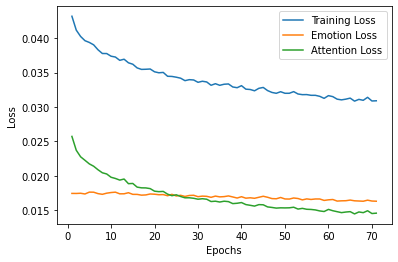

In [ ]:
import matplotlib.pyplot as plt

lossVals = history.history['loss']
emotionLossVals = history.history['emotionalOutput_loss']
attnLossVals = history.history['attentionOutput_loss']
epochs = range(1, len(lossVals)+1)

plt.plot(epochs, lossVals, label='Training Loss')
plt.plot(epochs, emotionLossVals, label='Emotion Loss')
plt.plot(epochs, attnLossVals, label='Attention Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


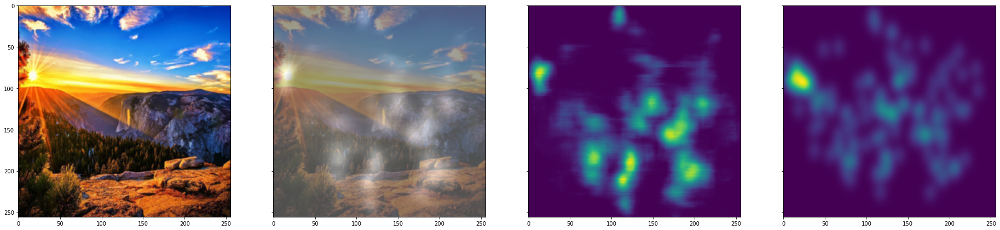

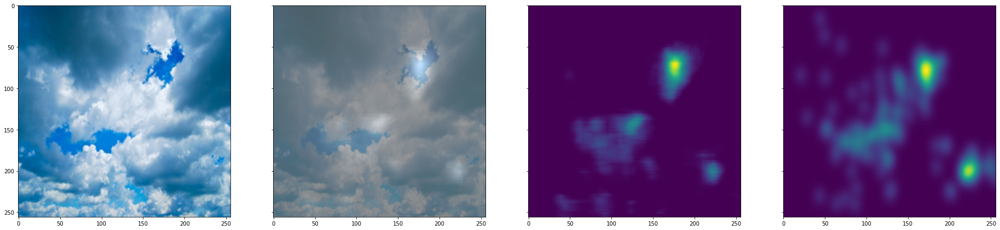

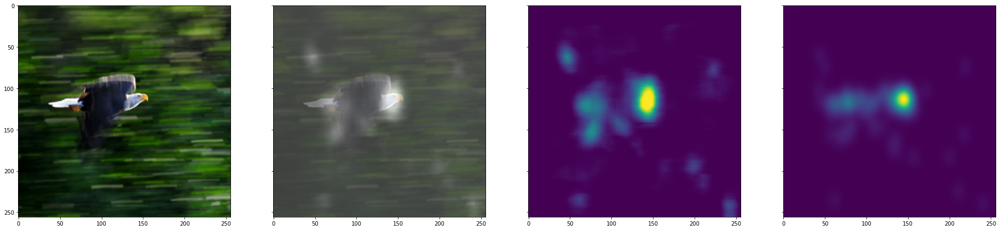

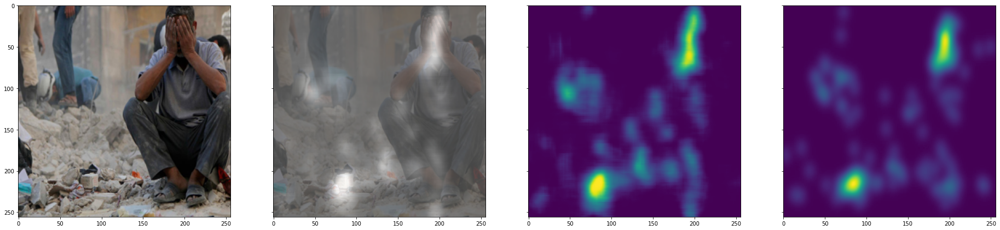

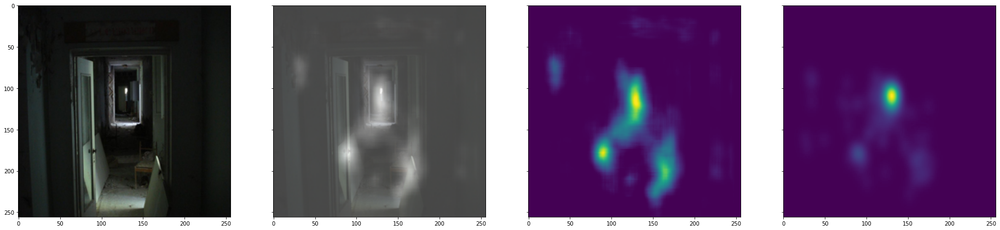

...

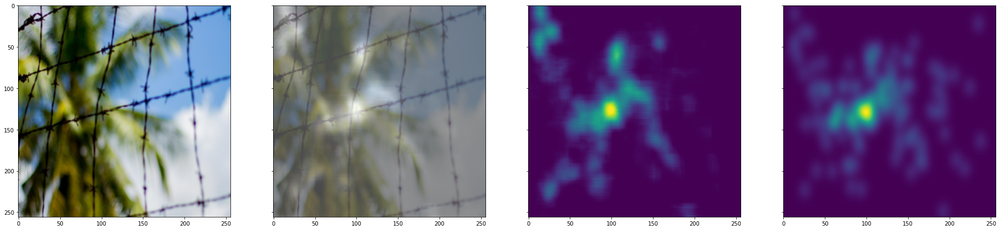

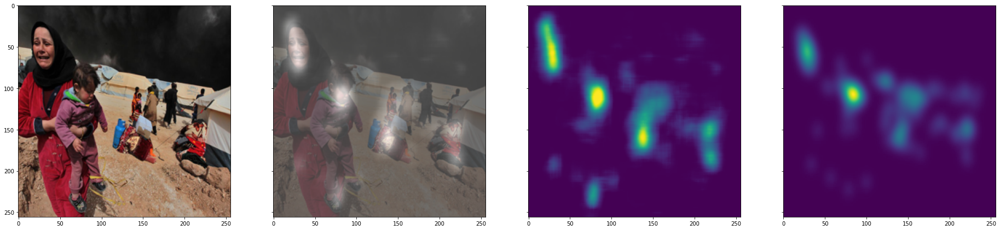

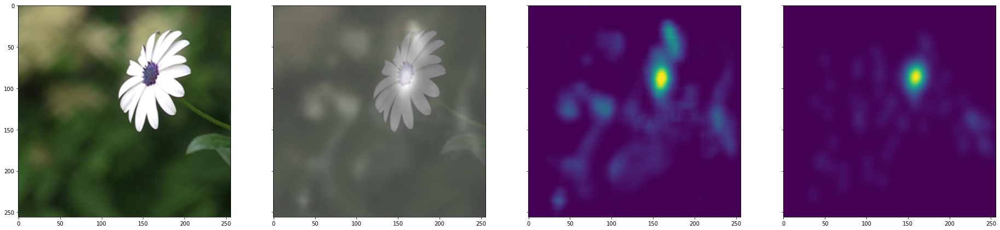

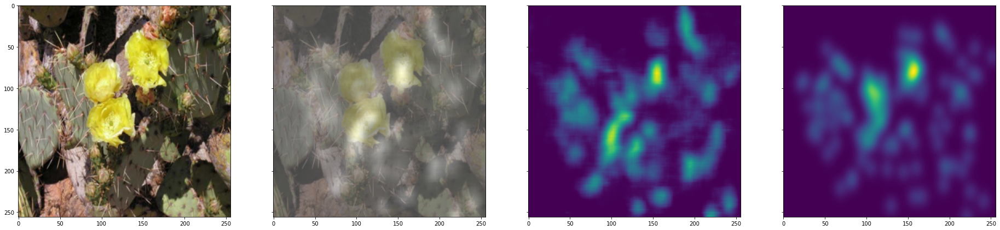

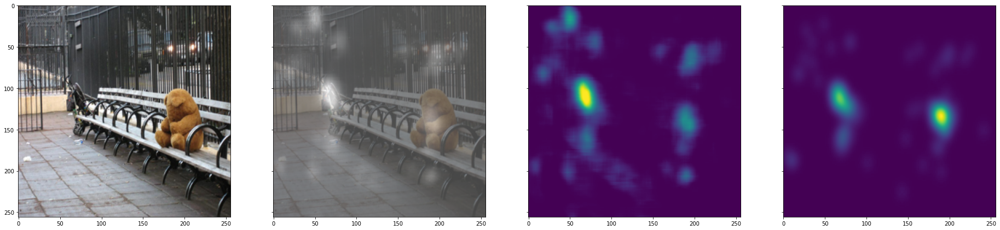

Buffered data was truncated after reaching the output size limit.

In [ ]:
import os
import glob
import numpy as np
import tensorflow as tf
import tensorflow.keras
import scipy
import matplotlib.pyplot as plt
import colorsys

SAMPLES = 100

def imageModifier(intensity):
  result = intensity / 3.
  intensity = result * (0. if result < 0 else 1.)
  return result

for i in range(SAMPLES):
  f, subplts = plt.subplots(1, 4, sharex=True, sharey=True, figsize=(8*4, 8*1))
  img = np.expand_dims(imageDS[i], axis=0)
  attention, emotion = model.predict(img)
  attnMap = (attention*255.)[0,:,:,0].astype(np.uint8)
  attnScalar = ((attention[0,:,:]*(2/3))+(1/3))*255.
  #print(img.shape)
  mod = np.vectorize(imageModifier)
  mergeImage = mod(img)[0]
  #print(mergeImage.shape)
  together = mergeImage + attnScalar
  together = (together * 255. / np.max(together)).astype(np.uint8)
  #attnDiff = abs(attentionDS[i] - attention[0,:,:,0])
  subplts[0].imshow(img[0].astype(np.uint8))
  subplts[1].imshow(together)
  subplts[2].imshow(attnMap)
  subplts[3].imshow((attentionDS[i]*255.).astype(np.uint8))